In [136]:
using QuadraticTeamDecisionSolver, Distributions, Statistics, LinearAlgebra, IterativeSolvers,  LaTeXStrings, Random, Plots

In [137]:
saveTo = "/home/fe/michelena/Schreibtisch/";
dpi=1000;

In [138]:
# Define the multivariate normal distribution parameters
μ = [0.0, 0.0]  # Mean

Σ = [1.0 0.1;
     0.1 1.0]  # Covariance matrix

# Generate random vectors from the multivariate normal distribution
D = MvNormal(μ, Σ);


In [139]:
# Define a grid of data points
L = range(-5, stop=5, length=30);

Ω = [[x,y] for x in L, y in L];


In [140]:
truth(x) = [sin(x[1])*cos(x[2]), -0.5*cos(x[1])*sin(x[2])]

truth (generic function with 1 method)

In [141]:
meas(x) = truth(x) + 0.1*rand(D);

In [142]:
Truth = hcat(truth.(Ω)...);

In [143]:
F = meas.(Ω);
T =  hcat(F...);
Y = [T[:,i] for i in 1:size(T,2)];

In [144]:
O = hcat(Ω...);
X = [O[:,i] for i in 1:size(T,2)];

In [145]:
Yh = Y .|> y -> y';

In [146]:
Covar =  sum(Y.*Yh)/length(Y)

2×2 Matrix{Float64}:
 0.263353    0.00178096
 0.00178096  0.0722116

$0.5M*exp(h_i) + 0.5M*exp(h_2)$

$\sum_{i}\exp(h_i^{-1}d(x,t))y_i\otimes y_i$

In [147]:
function matrixExponentialKernel(h::Vector{Float64}, M::Vector{<:Matrix}, λ::Vector{Float64}, x::Any, t::Any)
    return sum([a*exponentialKernel(x, t; h=l)*B for (a,l,B) in zip(λ, h, M)])
end

matrixExponentialKernel (generic function with 1 method)

In [148]:
K1(x,t) =  diagm([exponentialKernel(x, t; h=l) for l in h[1:2]])

K1 (generic function with 1 method)

In [149]:
h = [det(Covar), det(Σ)];

In [150]:
M = [Covar, Σ];

In [151]:
λ = [0.8, 0.2];

In [152]:
K2(x,t) = matrixExponentialKernel(h, M, λ, x, t)

K2 (generic function with 1 method)

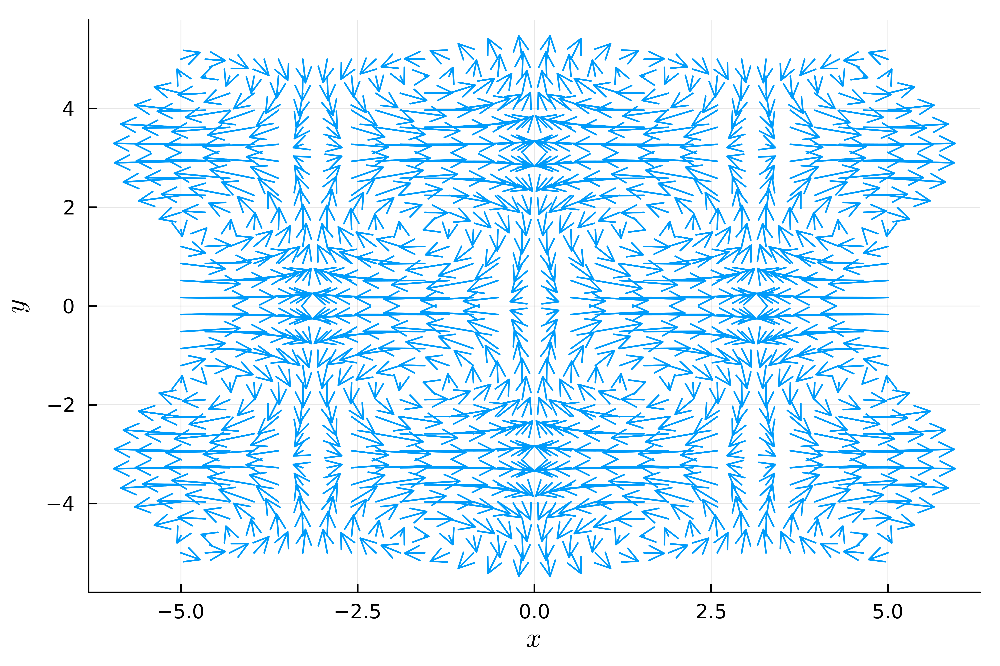

In [153]:
quiver(
	O[1, :],
	O[2, :],
	quiver = (Truth[1, :],
		Truth[2, :]),dpi=dpi
)
xlabel!(L"x")
ylabel!(L"y")
savefig(saveTo * "/vector-truth.png")
display(Plots.current())

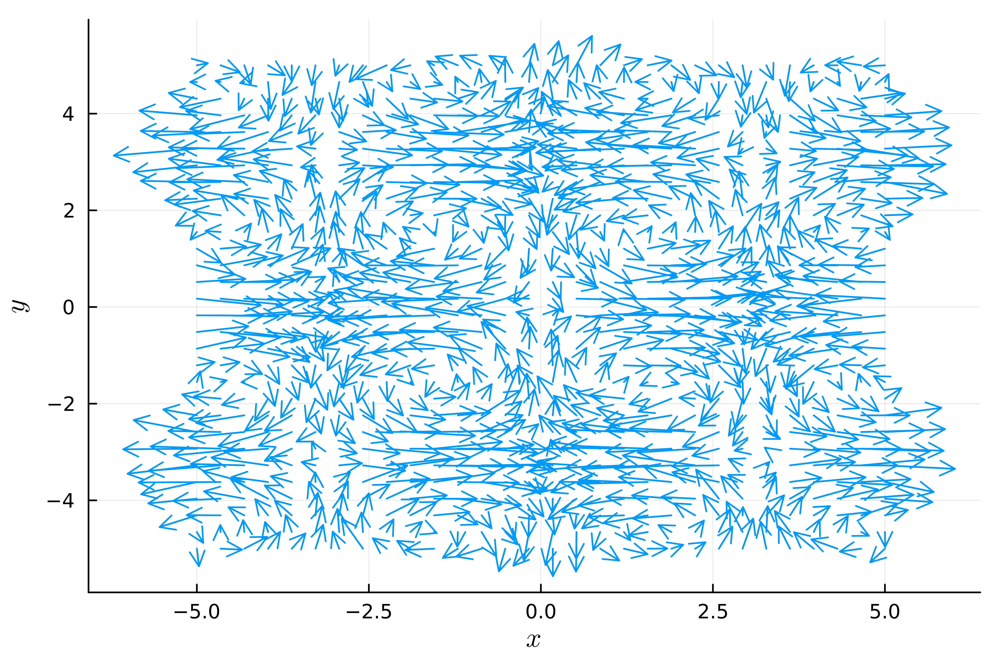

In [154]:

quiver(
	O[1, :],
	O[2, :],
	quiver = (T[1, :],
		T[2, :]),dpi=dpi
)
xlabel!(L"x")
ylabel!(L"y")
savefig(saveTo * "/vector-measurements.png")
display(Plots.current())

In [155]:
α1 = kernelRegression(K1, Y, X);
f1(x) = kernelFunction(K1, α1, X, x);
Tk1 = hcat(f1.(X)...);

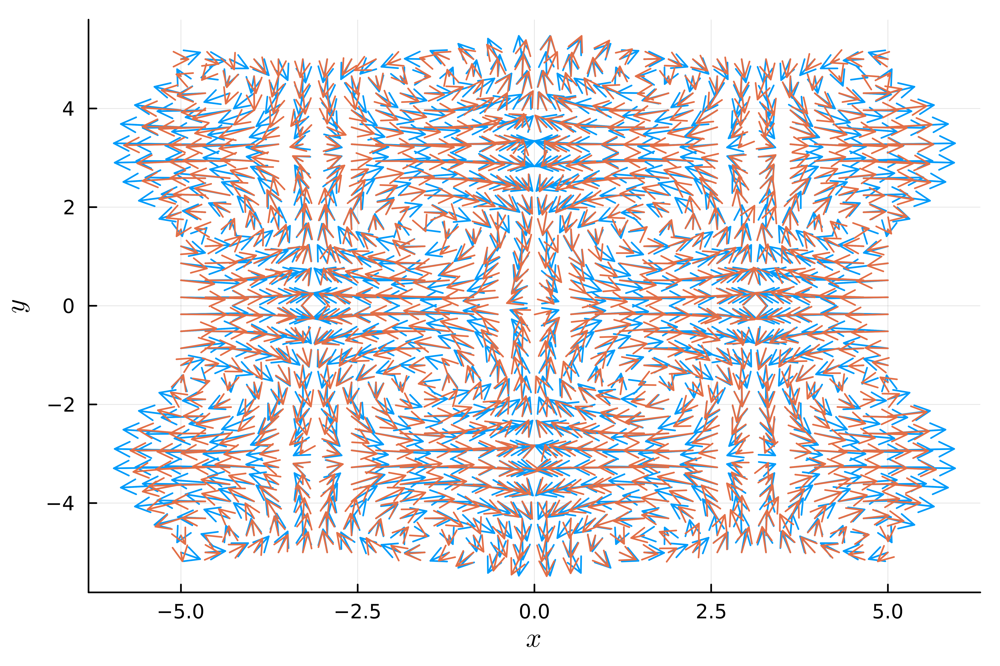

In [156]:
quiver(
	O[1, :],
	O[2, :],
	quiver = (Truth[1, :],
		Truth[2, :]),
	dpi = dpi,
)
quiver!(
	O[1, :],
	O[2, :],
	quiver = (Tk1[1, :],
		Tk1[2, :]),
	dpi = dpi,
)
xlabel!(L"x")
ylabel!(L"y")
savefig(saveTo * "/vector-diagonal-mixture.png")
display(Plots.current())


In [157]:
error_diag_kernel = norm(Truth - Tk1)/norm(Truth)

0.3218386048638248

In [158]:
α2 = kernelRegression(K2, Y, X);
f2(x) = kernelFunction(K2, α2, X, x);
Tk2 = hcat(f2.(X)...);

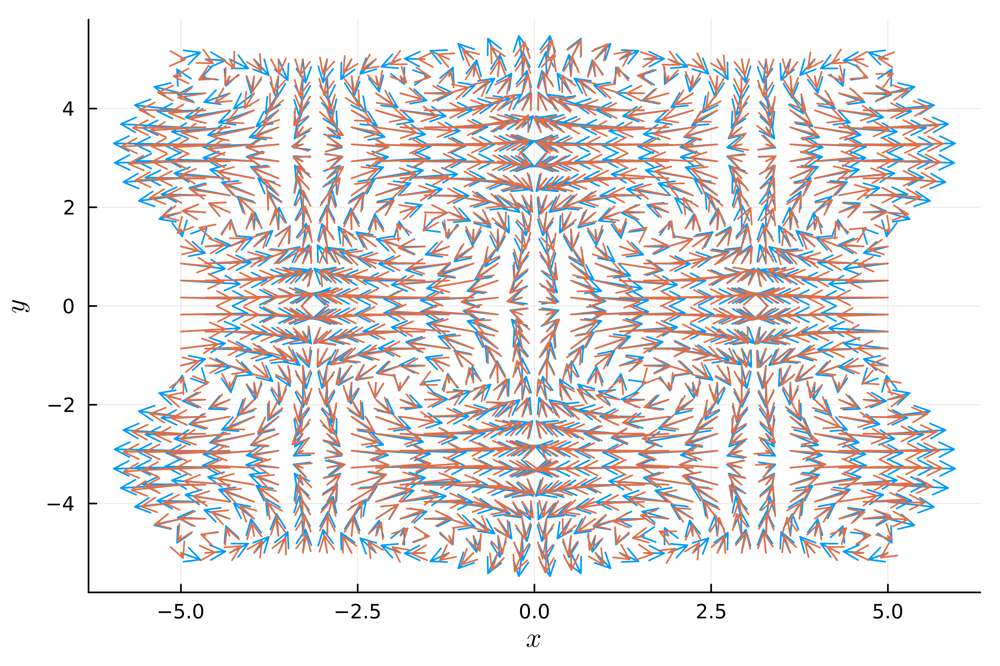

In [159]:
quiver(
	O[1, :],
	O[2, :],
	quiver = (Truth[1, :],
		Truth[2, :]),dpi=dpi
)
quiver!(
	O[1, :],
	O[2, :],
	quiver = (Tk2[1, :],
		Tk2[2, :]),
	label = L"f(x) = \sum_{l=1}^n \mu_l k(x,x^{(l)})", dpi = dpi,
)
xlabel!(L"x")
ylabel!(L"y")
savefig(saveTo * "/vector-gaussian-mixture.png")
display(Plots.current())

In [160]:
error_exp_kernel = norm(Truth - Tk2)/norm(Truth)

0.17051453406207898

In [161]:
complexY = [y[1] + y[2]im for y in vec(Y)];

In [162]:
K3(x,t) = exponentialKernel(x, t; h=0.05)

K3 (generic function with 1 method)

In [163]:
α3 = kernelRegression(K3, complexY, X);
f3(x) = kernelFunction(K3, α3, X, x);
F3 = f3.(X);

In [164]:
Tk3 = hcat((F3 .|> x -> vcat([real(x), imag(x)]...))...);

2×900 Matrix{Float64}:
  0.0293371   0.215072   0.229804  0.127451  …  -0.242286   -0.21139
 -0.24701    -0.0133745  0.173677  0.245339      0.0482182  -0.0120618

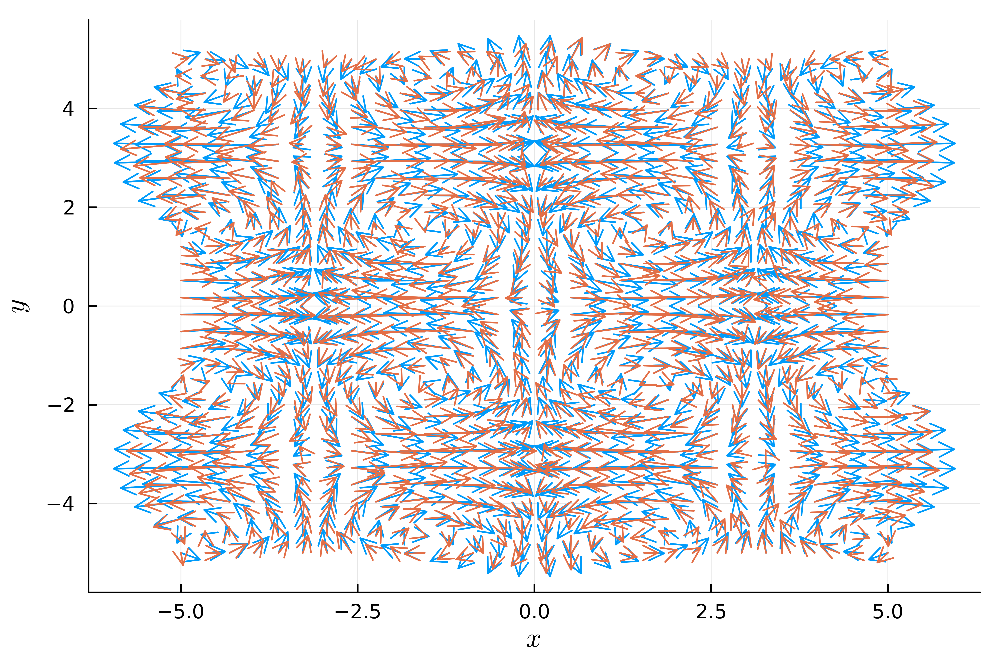

In [165]:
quiver(
	O[1, :],
	O[2, :],
	quiver = (Truth[1, :],
		Truth[2, :]),dpi=dpi
)
quiver!(
	O[1, :],
	O[2, :],
	quiver = (Tk3[1, :],
		Tk3[2, :]),
	label = L"f(x) = \sum_{l=1}^n \mu_l k(x,x^{(l)})",dpi=dpi
)
xlabel!(L"x")
ylabel!(L"y")
savefig(saveTo * "/vector-complex-mixture.png")
display(Plots.current())

In [166]:
error_complex_kernel = norm(Truth - Tk3)/norm(Truth)

0.31219706418832155